----
DATA PROCESSING, DATA PREPARING
---

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler

In [3]:
data = pd.read_csv('breast-cancer.csv')


In [4]:
# display data types and check for missing values
print(data.dtypes)
print(data.isnull().sum())

id                           int64
diagnosis                   object
radius_mean                float64
texture_mean               float64
perimeter_mean             float64
area_mean                  float64
smoothness_mean            float64
compactness_mean           float64
concavity_mean             float64
concave points_mean        float64
symmetry_mean              float64
fractal_dimension_mean     float64
radius_se                  float64
texture_se                 float64
perimeter_se               float64
area_se                    float64
smoothness_se              float64
compactness_se             float64
concavity_se               float64
concave points_se          float64
symmetry_se                float64
fractal_dimension_se       float64
radius_worst               float64
texture_worst              float64
perimeter_worst            float64
area_worst                 float64
smoothness_worst           float64
compactness_worst          float64
concavity_worst     

In [5]:
# 'diagnosis' is a categorical attribute, change its type to "category"
data["diagnosis"] = data["diagnosis"].astype('category')
# new column for the categorical attribute and convert its values to numeric codes
data["diagnosis_cat"] = data["diagnosis"].cat.codes
# datatypes of the dataset columns to confirm changes
data.dtypes

id                            int64
diagnosis                  category
radius_mean                 float64
texture_mean                float64
perimeter_mean              float64
area_mean                   float64
smoothness_mean             float64
compactness_mean            float64
concavity_mean              float64
concave points_mean         float64
symmetry_mean               float64
fractal_dimension_mean      float64
radius_se                   float64
texture_se                  float64
perimeter_se                float64
area_se                     float64
smoothness_se               float64
compactness_se              float64
concavity_se                float64
concave points_se           float64
symmetry_se                 float64
fractal_dimension_se        float64
radius_worst                float64
texture_worst               float64
perimeter_worst             float64
area_worst                  float64
smoothness_worst            float64
compactness_worst           

In [21]:
reduced_data = data[['radius_mean','texture_mean','perimeter_mean','area_mean','smoothness_mean','compactness_mean','concavity_mean','concave points_mean','symmetry_mean','fractal_dimension_mean','radius_se','texture_se','perimeter_se','area_se','smoothness_se','compactness_se','concavity_se','concave points_se','symmetry_se','fractal_dimension_se','radius_worst','texture_worst','perimeter_worst','area_worst','smoothness_worst','compactness_worst','concavity_worst','concave points_worst','symmetry_worst','fractal_dimension_worst', 'diagnosis_cat']]

# descriptive statistics and information about the dataset
print(reduced_data.describe())
print(reduced_data.info())

       radius_mean  texture_mean  perimeter_mean    area_mean  \
count   569.000000    569.000000      569.000000   569.000000   
mean     14.127292     19.289649       91.969033   654.889104   
std       3.524049      4.301036       24.298981   351.914129   
min       6.981000      9.710000       43.790000   143.500000   
25%      11.700000     16.170000       75.170000   420.300000   
50%      13.370000     18.840000       86.240000   551.100000   
75%      15.780000     21.800000      104.100000   782.700000   
max      28.110000     39.280000      188.500000  2501.000000   

       smoothness_mean  compactness_mean  concavity_mean  concave points_mean  \
count       569.000000        569.000000      569.000000           569.000000   
mean          0.096360          0.104341        0.088799             0.048919   
std           0.014064          0.052813        0.079720             0.038803   
min           0.052630          0.019380        0.000000             0.000000   
25%      

In [22]:
my_working_dataset=reduced_data.copy()
my_working_dataset['diagnosis_cat']=my_working_dataset['diagnosis_cat'].fillna(my_working_dataset['diagnosis_cat'].mean())
#Dataset data are displayed
print(my_working_dataset.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 31 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   radius_mean              569 non-null    float64
 1   texture_mean             569 non-null    float64
 2   perimeter_mean           569 non-null    float64
 3   area_mean                569 non-null    float64
 4   smoothness_mean          569 non-null    float64
 5   compactness_mean         569 non-null    float64
 6   concavity_mean           569 non-null    float64
 7   concave points_mean      569 non-null    float64
 8   symmetry_mean            569 non-null    float64
 9   fractal_dimension_mean   569 non-null    float64
 10  radius_se                569 non-null    float64
 11  texture_se               569 non-null    float64
 12  perimeter_se             569 non-null    float64
 13  area_se                  569 non-null    float64
 14  smoothness_se            5

In [23]:
print(my_working_dataset['diagnosis_cat'].value_counts())


diagnosis_cat
0    357
1    212
Name: count, dtype: int64


In [24]:
float_columns = my_working_dataset.select_dtypes(include=['float64']).columns
float_columns

Index(['radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean',
       'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst'],
      dtype='object')

In [25]:
columns = ['radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean', 'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean', 'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se', 'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se', 'fractal_dimension_se', 'radius_worst', 'texture_worst', 'perimeter_worst', 'area_worst', 'smoothness_worst', 'compactness_worst', 'concavity_worst', 'concave points_worst', 'symmetry_worst', 'fractal_dimension_worst']

for column in columns:
    my_working_dataset[column] = (my_working_dataset[column] - my_working_dataset[column].min()) / (my_working_dataset[column].max() - my_working_dataset[column].min())

print(my_working_dataset.head(10))
print(my_working_dataset.describe())

   radius_mean  texture_mean  perimeter_mean  area_mean  smoothness_mean  \
0     0.521037      0.022658        0.545989   0.363733         0.593753   
1     0.643144      0.272574        0.615783   0.501591         0.289880   
2     0.601496      0.390260        0.595743   0.449417         0.514309   
3     0.210090      0.360839        0.233501   0.102906         0.811321   
4     0.629893      0.156578        0.630986   0.489290         0.430351   
5     0.258839      0.202570        0.267984   0.141506         0.678613   
6     0.533343      0.347311        0.523875   0.380276         0.379164   
7     0.318472      0.376057        0.320710   0.184263         0.598267   
8     0.284869      0.409537        0.302052   0.159618         0.674099   
9     0.259312      0.484613        0.277659   0.140997         0.595558   

   compactness_mean  concavity_mean  concave points_mean  symmetry_mean  \
0          0.792037        0.703140             0.731113       0.686364   
1          0.

----
DATA VISUALIZATION
---

<Axes: >

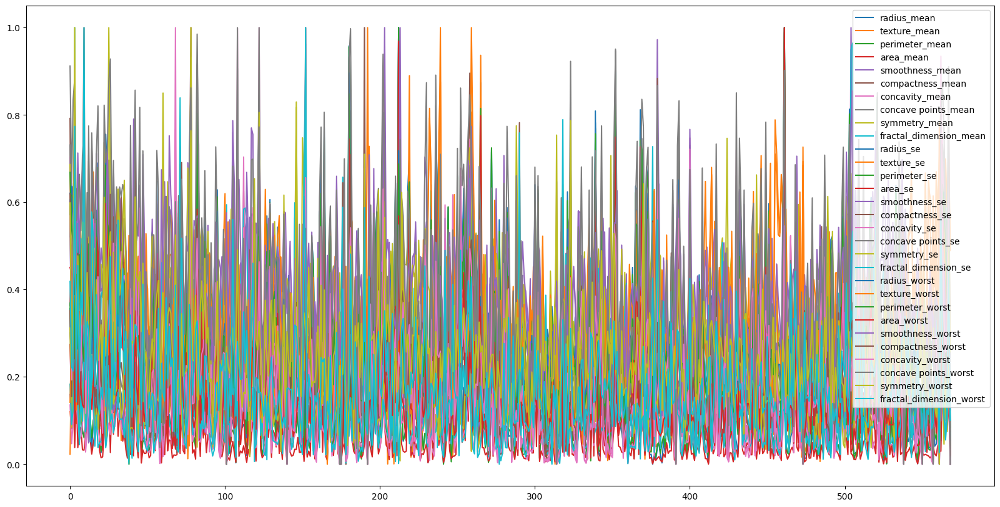

In [26]:
#Only attributes with numeric values on a continuous scale are selected for value visualisation
data_for_visualisation = my_working_dataset[[
    'radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean', 'smoothness_mean',
    'compactness_mean', 'concavity_mean', 'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
    'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
    'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se', 'fractal_dimension_se',
    'radius_worst', 'texture_worst', 'perimeter_worst', 'area_worst', 'smoothness_worst',
    'compactness_worst', 'concavity_worst', 'concave points_worst', 'symmetry_worst', 'fractal_dimension_worst'
]]
#Representing values
data_for_visualisation.plot(figsize=(20,10))

Because the plot we received beingalmost unredable fue to the big dataset we are going to split in into smaller subsetrs

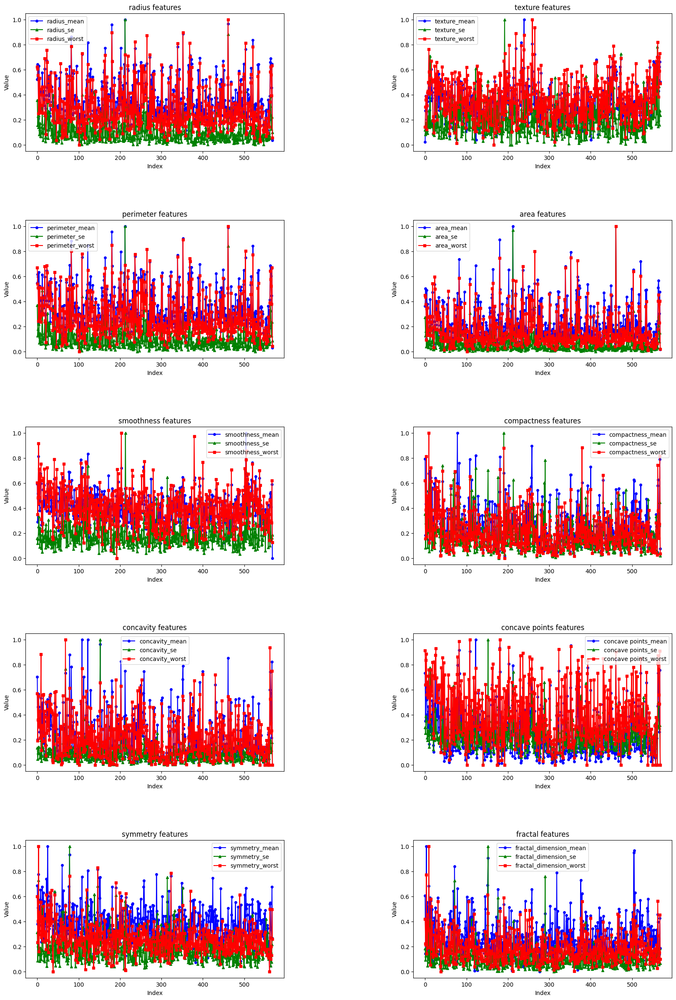

In [27]:
import matplotlib.pyplot as plt


data_for_visualisation = my_working_dataset[[
    'radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean', 'smoothness_mean',
    'compactness_mean', 'concavity_mean', 'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
    'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
    'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se', 'fractal_dimension_se',
    'radius_worst', 'texture_worst', 'perimeter_worst', 'area_worst', 'smoothness_worst',
    'compactness_worst', 'concavity_worst', 'concave points_worst', 'symmetry_worst', 'fractal_dimension_worst'
]]

fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(20, 30))
fig.subplots_adjust(hspace=0.5, wspace=0.5)
categories = ['mean', 'se', 'worst']
colors = ['blue', 'green', 'red']
markers = ['o', '^', 's']

for i, category in enumerate(categories):
    subset = [col for col in data_for_visualisation.columns if category in col]
    for j, feature in enumerate(subset):
        ax = axes[j // 2, j % 2]
        ax.plot(data_for_visualisation.index, data_for_visualisation[feature], label=f"{feature}", color=colors[i], marker=markers[i], markersize=4, linestyle='-')
        ax.set_title(f"{feature.split('_')[0]} features")
        ax.set_xlabel('Index')
        ax.set_ylabel('Value')
        ax.legend()

plt.show()


Based on the visualized data:

- **Radius, Texture, and Perimeter Features**: Generally, all these features exhibit higher values in their 'worst' state compared to their 'mean' and 'standard error' (SE) states. The similarity in patterns across these features suggests that they are closely related, possibly contributing similarly to the observed conditions.

- **Area Features**: Display pronounced variability, particularly in the 'worst' condition. This suggests that the area measurements significantly distinguish between typical and extreme cases.

- **Smoothness and Compactness Features**: These attributes show consistent increases from 'mean' to 'worst', with 'smoothness' experiencing slightly less variation in the SE state compared to 'compactness'. Both features change in tandem, indicating they might be influenced by similar factors.

- **Concavity and Concave Points Features**: These features show significant escalation from 'mean' to 'worst', highlighting their importance in describing more severe conditions. The peaks in the 'worst' state are much higher than in the 'mean', suggesting a strong link to the severity of the conditions.

- **Symmetry and Fractal Dimension Features**: While these features are less variable than others, they still show noticeable increases in their 'worst' states. This increase suggests a deterioration in symmetry and complexity in more severe cases.


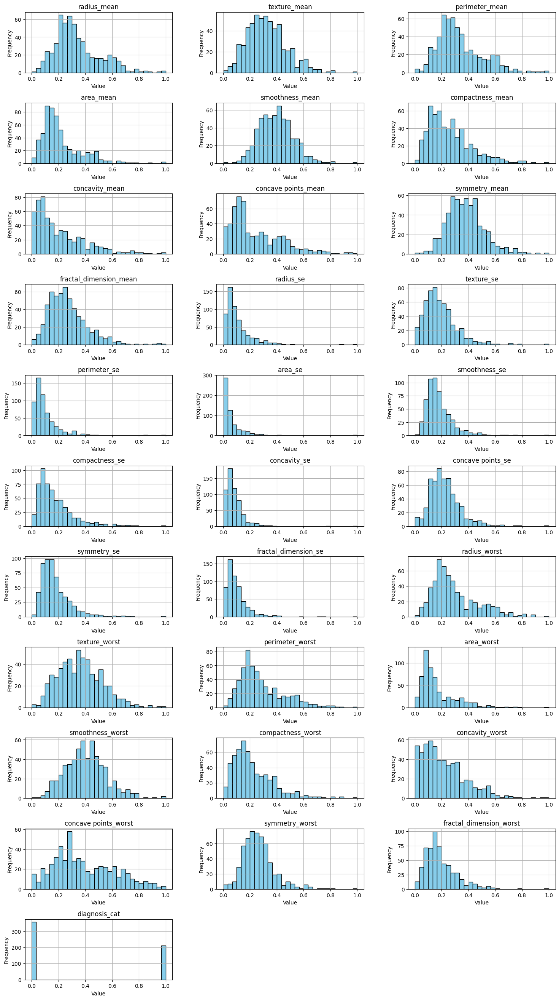

In [34]:
data_for_visualisation = my_working_dataset
num_cols = len(data_for_visualisation.columns)

# Calculate the number of rows and columns for the subplots
nrows = int(np.ceil(num_cols / 3))

# Create the subplots
fig, axes = plt.subplots(nrows=nrows, ncols=3, figsize=(18, nrows*3))
fig.subplots_adjust(hspace=0.5, wspace=0.3)

# Flatten the axes array in case it's multidimensional
axes = axes.flatten()

for i, column in enumerate(data_for_visualisation.columns):
    ax = axes[i]
    data_for_visualisation[column].hist(bins=30, ax=ax, color='skyblue', edgecolor='black')
    ax.set_title(column)
    ax.set_xlabel('Value')
    ax.set_ylabel('Frequency')

# Remove the unused subplots
if num_cols % 3:
    for idx in range(num_cols, nrows*3):
        fig.delaxes(axes[idx])

plt.show()

The histograms represent a distribution of various measurements typically used in medical or biological data analysis, likely detailing characteristics such as radius, texture, and smoothness among others. Many histograms show a skewed distribution, particularly in standard error and 'worst' categories, indicating variability in how these features are expressed in different cases, such as in a medical condition or biological samples. The presence of a histogram labeled "diagnosis_cat" with very uneven bars suggests the dataset contains unbalanced classes, which could affect the performance of analytical models trained on this data.

In [35]:
#Creating a pairplot
my_pairplot = sns.pairplot(my_working_dataset,hue='diagnosis_cat',palette="muted",height=3,vars=[
    'radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean', 'smoothness_mean',
    'compactness_mean', 'concavity_mean', 'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
    'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
    'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se', 'fractal_dimension_se',
    'radius_worst', 'texture_worst', 'perimeter_worst', 'area_worst', 'smoothness_worst',
    'compactness_worst', 'concavity_worst', 'concave points_worst', 'symmetry_worst', 'fractal_dimension_worst'
],kind='scatter')

#Extra space to display the title correctly
plt.subplots_adjust(top=0.9)
#Giving a title of the pairplot
my_pairplot.fig.suptitle('Feature pairplot',fontsize=25,color='b',alpha=0.5)

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


Text(0.5, 0.98, 'Feature pairplot')

The pairplot processed demonstrates relationships among a large number of features:

**Effective Class Separation:**
- Certain pairs of features such as "radius_mean" and "concavity_mean", or "texture_mean" and "perimeter_worst" provide clear class separation. This distinction suggests these features could be highly effective for classification tasks, as the classes (representing different conditions or diagnoses) are well-distinguished.

**Ineffective Class Separation:**
- However, some feature pairs like "radius_se" and "smoothness_se", or "texture_worst" and "fractal_dimension_worst" display significant overlap among classes. In these plots, data points of different colors intermingle, indicating that these features alone may not be sufficient for reliable class separation in a predictive model.

**General Observations:**
- Diagonal plots showing the distribution of individual features reveal varied statistical distributions, with some exhibiting clear bimodal characteristics. This indicates potential subgroups within the dataset, which might correspond to different categories or conditions being studied.

**Abstract:**
The pairplot analysis underscores the varied ability of feature combinations to distinguish between classes in a dataset, potentially geared towards medical diagnosis. It highlights pairs of features that could be leveraged for effective classification due to their clear class separation, while also pointing out those that are less capable.

<Axes: >

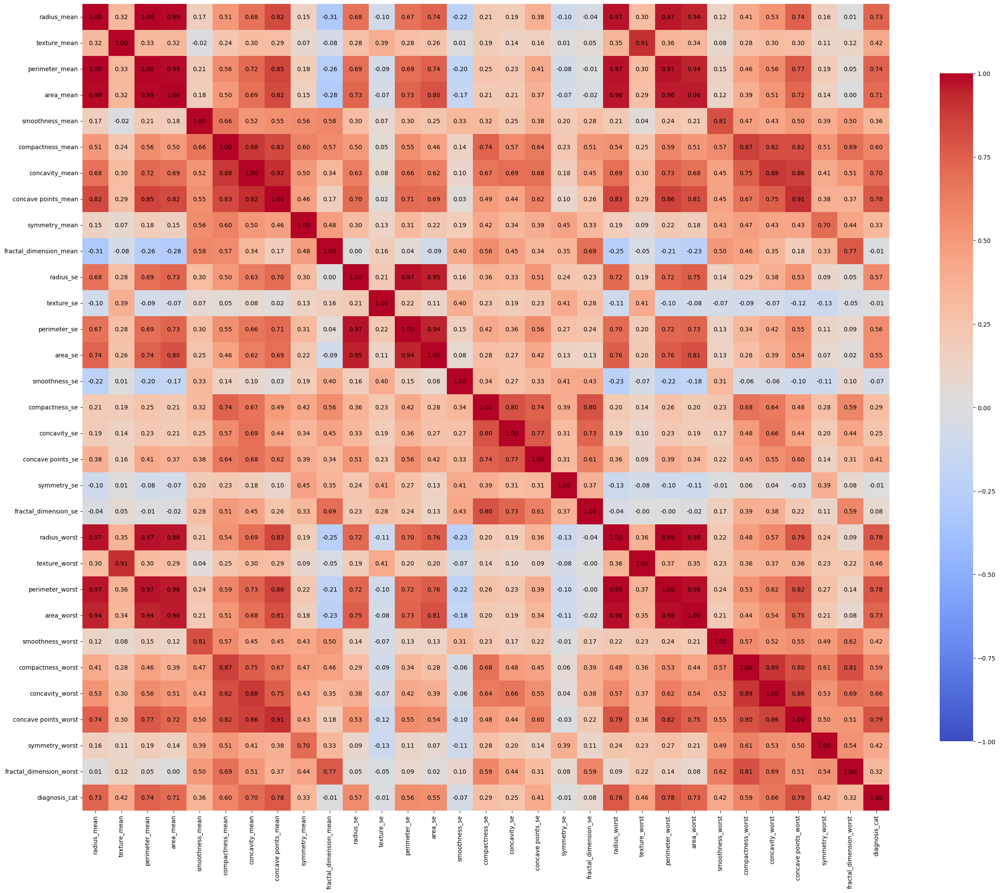

In [41]:
#A correlation matrix is created, showing the correlation coefficient for the numeric features
my_correlation_matrix=data_for_visualisation.corr(method='pearson')
plt.figure(figsize=(30,25))


# Create a heatmap
sns.heatmap(my_correlation_matrix, vmax=1, vmin=-1, square=True, annot=True, fmt=".2f",
            cmap='coolwarm', annot_kws={'size': 10, 'color': 'black'}, cbar_kws={"shrink": .8})



The correlation matrix analysis shows that:

1. **Strong Positive Correlations:**
   - Features such as **"radius_mean"**, **"perimeter_mean"**, **"area_mean"**, and their respective 'worst' counterparts show very strong positive correlations, indicating that these features vary together in a consistent manner. This implies that as one metric increases, the others do as well, which could be indicative of tumor size or spread.

2. **Significant Negative Correlations:**
   - **"fractal_dimension_se"** shows a negative correlation with several major size metrics like **"radius_worst"**, **"perimeter_worst"**, and **"area_worst"**. This suggests that as the fractal dimension (complexity) of the tissue increases, the size measurements in their worst states decrease.

3. **Diagnostic Relevance:**
   - The **"diagnosis_cat"** feature exhibits a high positive correlation with features like **"concavity_worst"** and **"concave points_worst"**, indicating that these are strong predictors of the diagnosis category. The correlation values close to 0.8 highlight their potential utility in distinguishing between different diagnostic categories.

### Implications:

- **Multicollinearity Concerns:** Given the high correlation between features like **"radius_worst"** and **"perimeter_worst"**, including both in a predictive model may lead to multicollinearity, complicating the interpretation of the model’s output. This could obscure the individual effect of each feature within linear regression analyses.

- **Feature Selection for Analysis:** In light of the above, it is advisable to carefully select features for further analysis to avoid redundancy. Techniques such as Principal Component Analysis (PCA) or manual feature elimination could be beneficial in refining the model and ensuring more accurate interpretations.


-----
K-means algorithm
-----